In [ ]:
# import own functions from reddit_funcs.py
try:
    from RedditHP import *
except ModuleNotFoundError:
    !pip install -r requirements.txt
    from RedditHP import *


# DATA_FOLDER = 'reddit_data'
# RAW_DATA_FILENAME = os.path.join(DATA_FOLDER, 'HP_raw_data.csv')
# PROCESSED_FILENAME = os.path.join(DATA_FOLDER, 'HP_processed_data.csv')
# AUTHOR_SUBREDDIT_FILENAME = os.path.join(DATA_FOLDER, 'HP_author_subreddit_data.csv')
# AUTHOR_POSTS_FILENAME = os.path.join(DATA_FOLDER, 'HP_chosen_author_posts_data.csv')
# SUBREDDIT_COMMENTS_RAW = os.path.join(DATA_FOLDER, 'HP_comments_raw.csv')
# SUBREDDIT_COMMENTS_PROCESSED = os.path.join(DATA_FOLDER, 'HP_comments_processed.csv')

# if not os.path.isdir(DATA_FOLDER):
#     os.mkdir(DATA_FOLDER)

In [ ]:
from RedditHP import *

In [ ]:
# get data and preprocess
df_submissions = get_data()
df_submissions = preprocess(df_submissions)
# print(df_submissions)

In [ ]:
# subreddits for top users
author_subreddits = get_top_author_subreddits(df_submissions)
author_subreddits.sort_values(by='author')

,author,subreddit,subreddit_id
1798,200020124,harrypotter,t5_2qiqi
1146,200020124,AskReddit,t5_2qh1i
2880,200020124,memes,t5_2qjpg
226,200020124,harrypotter,t5_2qiqi
3467,200020124,harrypotter,t5_2qiqi
...,...,...,...
1342,urmomagayy,AskReddit,t5_2qh1i
1419,urmomagayy,teenagers,t5_2rjli
1557,urmomagayy,teenagers,t5_2rjli
1145,urmomagayy,teenagers,t5_2rjli


# Downloading Reddit Data

First we download data from the r/harrypotter subreddit

In [ ]:
from RedditHP import *

df_submissions = get_data()
# print(df_submissions)

Loading existing raw data
Loaded raw data


In [ ]:
# api = PushshiftAPI()

In [ ]:
# if os.path.exists(RAW_DATA_FILENAME):
#     print('Loading existing raw data')
#     df_submissions = pd.read_csv(RAW_DATA_FILENAME)
#     print('Loaded raw data')
# else:
#     my_subreddit = "harrypotter"
#     date1 = int(datetime.datetime(2021, 1, 1).timestamp())
#     date2 = int(datetime.datetime(2021, 3, 25).timestamp())
#     #query = "Gryffindor"

#     gen = api.search_submissions(subreddit = my_subreddit,
#                                 after = date1,
#                                 before = date2)

#     results = list(gen)

#     df_submissions = pd.DataFrame([(p.d_["title"], 
#                         p.d_["id"], 
#                         p.d_["score"], 
#                         p.d_["created_utc"],
#                         datetime.datetime.utcfromtimestamp(p.d_["created_utc"]).strftime("%Y-%m-%d"),
#                         p.d_["author"],
#                         p.d_["num_comments"],
#                         p.d_["author_flair_css_class"]) 
#                         for p in results], 
#                         columns = ["title", "id", "score", "created_utc", "creation_date", "author", "num_comments", 
#                         "house_id"])

#     # remove entries with no house
#     df_submissions = df_submissions.dropna().reset_index(drop=True)

Loading existing raw data
Loaded raw data


In [ ]:
# # Save raw data to csv, so we don't have to fetch it again
# if not os.path.exists(RAW_DATA_FILENAME):
#     print('Saving raw data file..')
#     df_submissions.to_csv(RAW_DATA_FILENAME, index=False)
#     print(f'Raw data saved to {RAW_DATA_FILENAME}')

# Preprocessing Data
We now preprocess the raw data from r/harrypotter

First we add a _house_ attribute to the submissions dataframe containing the name of the Hogwarts House of the user

In [ ]:
df_submissions = preprocess(df_submissions)

NameError: name 'preprocess' is not defined

In [ ]:
# house_id = 'house_id'
# if os.path.exists(PROCESSED_FILENAME):
#     df_submissions = pd.read_csv(PROCESSED_FILENAME)
# else:
#     # Preprocess
#     df_submissions["house"] = df_submissions[house_id].apply(lambda x: 'Gryffindor' if 'GR' in x
#                                                                 else 'Slytherin' if 'SL' in x
#                                                                 else 'Hufflepuff' if 'HF' in x
#                                                                 else 'Ravenclaw' if 'RV' in x
#                                                                 else None
#     )

#     # Drop nodes with non of the four houses
#     df_submissions.dropna(subset=['house']).reset_index(drop=True, inplace=True)

#     df_submissions.to_csv(PROCESSED_FILENAME, index=False)

In [ ]:
# df_submissions

# Selecting User Nodes
We now want to select user nodes from the r/harrypotter subreddit that we know have posts on other subreddit forums

In [ ]:
# def get_author_subreddits(authors):
#     date1 = int(datetime.datetime(2021, 1, 1).timestamp())
#     date2 = int(datetime.datetime(2021, 3, 25).timestamp())

#     gen = api.search_submissions(author=authors,
#                                 after = date1,
#                                 before = date2,
#                                 filter=['author', 'subreddit', 'subreddit_id'])

#     results = list(gen)

#     author_subreddits = pd.DataFrame([(p.d_["author"], 
#                         p.d_["subreddit"], 
#                         p.d_["subreddit_id"]) 
#                         for p in results], 
#                         columns = ["author", "subreddit", 'subreddit_id'])

#     # remove entries with no house
#     return author_subreddits

In [ ]:
# # Looking at top X authors from r/harrypotter to not get time out from Pushshift
# X=100
# submissions_by_author = df_submissions.groupby('author').sum()
# top_X_submissions = submissions_by_author.sort_values(by='num_comments', ascending=False).head(X).reset_index()
# print(f'{len(top_X_submissions)} authors')
# top_X_submissions

In [ ]:
# authors = top_X_submissions['author']
# if os.path.exists(AUTHOR_SUBREDDIT_FILENAME):
#    author_subreddits = pd.read_csv(AUTHOR_SUBREDDIT_FILENAME)
# else:
#     author_subreddits = get_author_subreddits(authors)
#     author_subreddits.to_csv(AUTHOR_SUBREDDIT_FILENAME, index=False)

In [ ]:
# author_subreddits.sort_values(by='author')

In [ ]:
# Unique subreddits for each selected r/harrypotter author
unique_sub_reddits = author_subreddits.groupby('author').nunique().sort_values(by='subreddit', ascending=False)
unique_sub_reddits

In [ ]:
limit = 20 # Different subreddits
chosen_users = unique_sub_reddits[unique_sub_reddits['subreddit'] >= limit]
chosen_users

In [ ]:
chosen_users = chosen_users.index

# We now want to get comments and submissions from the chosen users

In [ ]:
# def get_author_posts(author):
#     date1 = int(datetime.datetime(2021, 1, 1).timestamp())
#     date2 = int(datetime.datetime(2021, 3, 25).timestamp())

#     submissions = api.search_submissions(author=author,
#                                 after = date1,
#                                 before = date2,
#                                 filter=['author', 'subreddit', 'title', 'selftext', 'id', 'created_utc'])

#     submission_results = list(submissions)

#     for s in submission_results:
#         s.d_['link_id'] = ''
#         s.d_['parent_id'] = ''
#         s.d_['text'] = s.d_['title'] + s.d_['selftext']

#     comments = api.search_comments(author=author,
#                                 after = date1,
#                                 before = date2,
#                                 filter=['author', 'subreddit', 'body', 'id', 'link_id', 'parent_id', 'created_utc'])

#     comment_results = list(comments)
#     for c in comment_results:
#         c.d_['text'] = c.d_['body']

#     author_posts = pd.DataFrame([(
#                         p.d_["id"],
#                         p.d_["author"], 
#                         p.d_["subreddit"], 
#                         p.d_["text"],
#                         p.d_["link_id"],
#                         p.d_["parent_id"],
#                         p.d_["created_utc"]) 
#                         for p in (submission_results + comment_results)], 
#                         columns = ["id", "author", 'subreddit', 'text', 'link_id', 'parent_id', 'created_utc'])
#     return author_posts

In [ ]:
if os.path.exists(AUTHOR_POSTS_FILENAME):
    author_posts = pd.read_csv(AUTHOR_POSTS_FILENAME)
else:
    author_posts = get_author_posts(chosen_users[0])
    for user in tqdm(chosen_users[1:]):
        posts = get_author_posts(user)
        author_posts = pd.concat([author_posts, posts], ignore_index=True)
    author_posts.to_csv(AUTHOR_POSTS_FILENAME, index=False)


author_posts

,id,author,subreddit,text,link_id,parent_id,created_utc
0,m6jt89,Bleepbloopbotz2,HPSlashFic,Can you guys rec some fics featuring a hot Ron ?,NaN,NaN,1615929815
1,m6diek,Bleepbloopbotz2,SocialJusticeInAction,In response to people being turned off a fanfi...,NaN,NaN,1615913432
2,m54ane,Bleepbloopbotz2,camphalfblood,"If the PJO series is a BIG success, how do you...",NaN,NaN,1615756091
3,m4vsxk,Bleepbloopbotz2,HPSlashFic,Who should I pair Draco with in my Harry/Ron f...,NaN,NaN,1615731305
4,m3svoh,Bleepbloopbotz2,HPfanfiction,Sirius gets a trial... and is found guilty.I t...,NaN,NaN,1615588158
...,...,...,...,...,...,...,...
11137,gj7rxh6,theweirdpotayytoo,WhatsWrongWithYourDog,In this context cancer is what is wrong with y...,t3_kwzmkh,t3_kwzmkh,1610620485
11138,gj5v0sm,theweirdpotayytoo,teenagers,Happy birthday,t3_kwgyx8,t3_kwgyx8,1610576237
11139,gixofgm,theweirdpotayytoo,teenagers,Me born on june 6 2006,t3_kv896t,t3_kv896t,1610404335
11140,giszkpa,theweirdpotayytoo,LesbianSexPorn,Who are they?,t3_ks4zo6,t3_ks4zo6,1610316217


# Finding Word Clouds for the selected users

In [ ]:
nltk.download('punkt')
nltk.download('stopwords')
from nltk.corpus import stopwords
from nltk import word_tokenize

[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Unzipping tokenizers/punkt.zip.
[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Unzipping corpora/stopwords.zip.


First we tokenize and clean the text of the users' posts

In [ ]:
SW = stopwords.words("english")

In [ ]:
sub_tokens = []
for text in tqdm(author_posts["text"]):
    # remove urls
    text = [w for w in text.split(" ") if not re.search(r"[/ \\]", w)]
    #get tokens

    tokens = [token.lower() for token in word_tokenize(" ".join(text)) 
              if token.lower() not in SW
             and token.isalpha()]
    sub_tokens.append(tokens)
    
author_posts["tokens"] = sub_tokens

100%|██████████| 11142/11142 [00:04<00:00, 2241.77it/s]


Then we create documents for the user posts

In [ ]:
def concat(series):
    document = []
    for tokens in series:
        document.extend(tokens)
    
    return document

author_text_docs = author_posts.groupby('author')['tokens'].apply(lambda x: concat(x))
author_text_docs

author
Bleepbloopbotz2         [guys, rec, fics, featuring, hot, ron, respons...
EquivalentInflation     [star, wars, obi, wan, chosen, know, prophecy,...
LiopleurodonMagic       [anyone, know, good, fm, station, weather, rel...
M-Saga                  [riz, ahmed, first, muslim, nominated, best, a...
Ok_Fennel6151           [akame, art, hqas, akame, art, seiorai, manga,...
PeevesPoltergist        [makes, queen, legendary, queen, legend, statu...
Psychological-Fall57    [moment, final, arci, thought, funny, jean, ye...
RunningTURTL            [watching, fortnite, season, event, remind, ce...
SirAren                 [billie, joe, instagram, account, happened, fa...
SkootNasty              [cover, call, al, yesterday, thought, might, d...
Vocadofries             [jankiest, close, reality, present, fears, lov...
amit0k                  [always, nice, remote, island, national, panda...
coolbean36              [good, dudley, goes, hogwarts, fanfics, prefer...
coolguydude56           [george

Now we can calculate the TF-IDF

In [ ]:
TF = []
for user in chosen_users:
    N = len(author_text_docs[user])
    freqdist = nltk.FreqDist(author_text_docs[user])
    tf = {word: round(count/N,5) for word, count in list(freqdist.most_common())}
    tf = nltk.FreqDist(tf)
    TF.append(tf)

for i, tf in enumerate(TF):
    word, _ = zip(*tf.most_common(5))
    print(f"{chosen_users[i]}: \t {word}")

terms = set().union(*[author_text_docs[user] for user in chosen_users])
N_docs = 16 # 15 stocks + other
all_users = list(author_text_docs.reset_index()['author'].values)
user_sets = [set(author_text_docs[user]) for user in all_users]

print('Calculating IDF...')
IDF = {}
for term in tqdm(terms):
    idf = np.log(N_docs/sum([term in user_set for user_set in user_sets]))
    IDF[term] = idf

print('Calculating TF-IDF...')
TF_IDF = []
for tf in TF:
    tf_idf = nltk.FreqDist({word:count * IDF[word] for word, count in tf.most_common() if IDF[word] > 0})
    TF_IDF.append(tf_idf)

for i, tf_idf in enumerate(TF_IDF):
    print(chosen_users[i])
    word_tf, _ = zip(*TF[i].most_common(10))
    print(f"{'Top 10 TF Words:':<30s}{word_tf}")
    word_tfidf, _ = zip(*tf_idf.most_common(10))
    print(f"{'Top 10 TF-IDF Words:':<30s}{word_tfidf}")
    print(f"{'Common words:':<30s}{set(word_tf).intersection(set(word_tfidf))}")
    print("\n")

100%|██████████| 17688/17688 [00:00<00:00, 200477.35it/s]Bleepbloopbotz2: 	 ('gt', 'harry', 'ron', 'like', 'hermione')
PeevesPoltergist: 	 ('gt', 'lt', 'pop', 'hello', 'like')
SirAren: 	 ('amp', 'like', 'movies', 'great', 'film')
Ok_Fennel6151: 	 ('like', 'avatar', 'show', 'would', 'korra')
RunningTURTL: 	 ('like', 'would', 'think', 'u', 'get')
EquivalentInflation: 	 ('people', 'like', 'would', 'also', 'one')
SkootNasty: 	 ('cover', 'curtis', 'lovejoy', 'original', 'thought')
M-Saga: 	 ('game', 'update', 'iphone', 'thanks', 'connect')
Psychological-Fall57: 	 ('like', 'think', 'really', 'character', 'would')
coolguydude56: 	 ('people', 'god', 'like', 'israel', 'one')
datavinci: 	 ('u', 'lol', 'like', 'would', 'gt')
coolbean36: 	 ('chocolatefrog', 'like', 'get', 'would', 'got')
Vocadofries: 	 ('like', 'people', 'one', 'would', 'get')
LiopleurodonMagic: 	 ('like', 'really', 'people', 'get', 'know')
amit0k: 	 ('day', 'national', 'one', 'would', 'like')
theweirdpotayytoo: 	 ('think', 'im', 

Then we can create the world clouds from the TF-IDF

In [ ]:
title_color = {
    'Gryffindor': 'red',
    'Slytherin': 'green',
    'Hufflepuff': 'yellow',
    'Ravenclaw': 'blue'
}
shield_mask = np.array(Image.open('wordcloud_contours/shield_contour.jpg'))

def create_wordclouds(users, height):
    width = int(len(users)/height)
    fig, ax = plt.subplots(height,width, dpi = 300, figsize = (20,30))
    titles = users
    font = {'family': 'serif',
            'weight': 'normal',
            'size': 20,
            }

    i = 0    
    for col in tqdm(range(width)):
        for row in tqdm(range(height)):
            user = users[i]
            user_house = df_submissions[df_submissions['author'] == user]['house'].iloc[0]
            user_color = title_color[user_house]
            wordcloud = WordCloud(width = 400*width,
                        height = 400*height,
                        max_words=100,
                        background_color ='white',
                        mask=shield_mask,
                        contour_width=3,
                        contour_color=user_color).generate_from_frequencies(dict(TF_IDF[i]))
            ax[row,col].imshow(wordcloud, interpolation='bilinear')
            ax[row,col].set_axis_off()
            ax[row,col].set_title(titles[i], fontdict = font)
            i += 1
        

    plt.show()

100%|██████████| 3/3 [00:18<00:00,  6.09s/it]


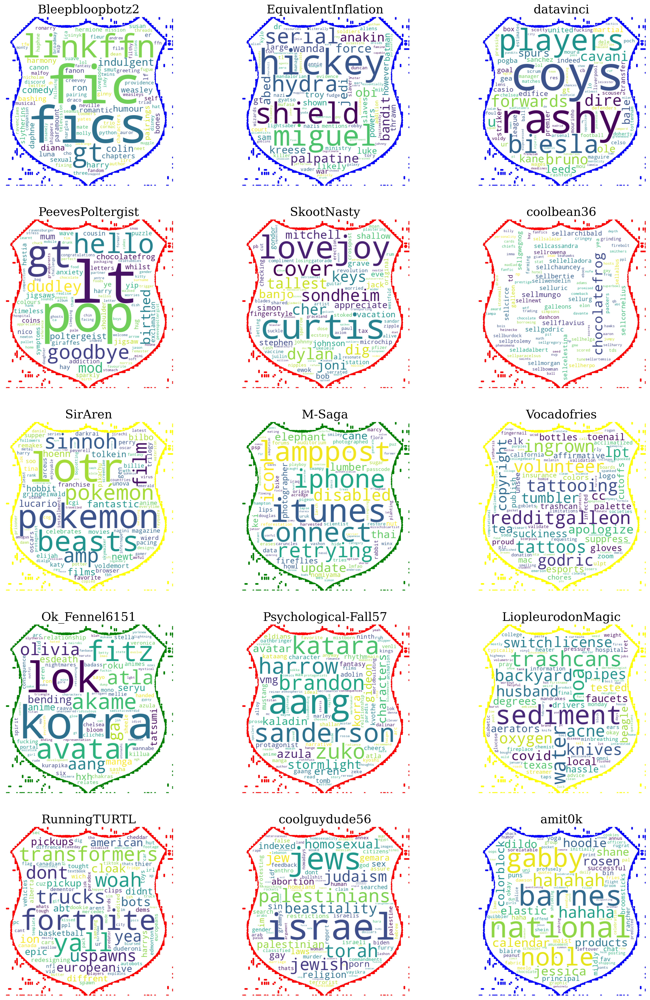

In [ ]:
create_wordclouds(chosen_users, height=5)

# Interactions between houses on r/harrypotter

## Get comments

In [ ]:
if os.path.exists(SUBREDDIT_COMMENTS_RAW):
    print('Loading existing raw data')
    df_submissions = pd.read_csv(SUBREDDIT_COMMENTS_RAW)
    print('Loaded raw data')
else:
    # get comments on harrypotter subreddit
    api = PushshiftAPI()
    my_subreddit = "harrypotter"
    date1 = int(datetime.datetime(2021, 1, 1).timestamp())
    date2 = int(datetime.datetime(2021, 3, 25).timestamp())


    # get comments in a for loop
    comments = []
    sub_ids = list(df_submissions[df_submissions["num_comments"] > 0]["id"])
    N = 50 #split api call in N bits
    step = len(sub_ids)/N
    for i in tqdm(range(N)):
        ids = sub_ids[int(round(i*step)):int(round((i+1)*step))]
        gen_comments = api.search_comments(subreddit = my_subreddit,
                                        after = date1,
                                        before = date2,
                                        link_id = ids,
                                        filter=['author', 'score', 'body', 'id', 'link_id', 'parent_id', 'created_utc', 'author_flair_css_class'])
        comments.extend(list(gen_comments))

    # save csv
    df_comments = pd.DataFrame([(p.d_["id"],
                             p.d_["link_id"],
                             p.d_["score"],
                             p.d_["created_utc"],
                             datetime.datetime.utcfromtimestamp(p.d_["created_utc"]).strftime("%Y-%m-%d"),
                             p.d_["author"],
                             p.d_["parent_id"],
                             p.d_["author_flair_css_class"],
                             p.d_["body"]) for p in comments], 
                             columns = [ "id", "submission_id", "score", "created_utc", "creation_date", "author", "parent_id", "house_id", "text"])
    df_comments.to_csv(SUBREDDIT_COMMENTS_RAW, index=False)

Loading existing raw data
Loaded raw data


## Preprocess comments

In [ ]:
house_id = 'house_id'
if os.path.exists(SUBREDDIT_COMMENTS_PROCESSED):
    df_comments = pd.read_csv(SUBREDDIT_COMMENTS_PROCESSED)
else:
    # Preprocess
    df_comments = df_comments.dropna(subset=[house_id]).reset_index(drop=True, inplace=False)
    df_comments["house"] = df_comments[house_id].apply(lambda x: 'Gryffindor' if 'GR' in x
                                                                else 'Slytherin' if 'SL' in x
                                                                else 'Hufflepuff' if 'HF' in x
                                                                else 'Ravenclaw' if 'RV' in x
                                                                else None
    )

    # Drop nodes with non of the four houses
    df_comments = df_comments.dropna(subset=['house']).reset_index(drop=True, inplace=False)

    # dictionaries
    comment_authors = dict(zip(df_comments["id"], df_comments["author"]))
    parent = dict(zip(df_comments["id"], df_comments["parent_id"]))
    submissions_authors = dict(zip(df_submissions["id"], df_submissions["author"]))
    author_house = dict(zip(df_comments["author"], df_comments["house"]))

    # function for getting author of parent id
    def get_parent_author(comment_id):
        parent_id = parent[comment_id]
        t_parent_id = parent_id[:3]
        parent_id = parent_id[3:]
        
        try:
            if t_parent_id == "t1_":
                return comment_authors[parent_id]# if parent_id in comment_authors.keys else None
            elif t_parent_id == "t3_":
                return submissions_authors[parent_id]
            else:
                return -1
        except KeyError:
            return -1
        
    # create parent_author column in comments dataframe
    df_comments["parent_author"] = list(map(get_parent_author, df_comments["id"])) #get_parent_author(comments.id)
    
    # add the house of the parent author to a column
    df_comments["parent_house"] = [author_house[parent_author] if parent_author in author_house.keys() else "None" for parent_author in df_comments["parent_author"]]

    # remove unwanted authors
    df_comments.parent_author = df_comments.parent_author.replace(-1, "None")
    df_comments = df_comments[(df_comments.author != "[deleted]") & (df_comments.parent_author != "[deleted]")]# remove deleted users


    df_comments.to_csv(SUBREDDIT_COMMENTS_PROCESSED, index=False)

In [ ]:
df_comments

,id,submission_id,score,created_utc,creation_date,author,parent_id,house_id,text,house,parent_author,parent_house
0,gr9655k,t3_m72gsq,1,1615999802,2021-03-17,SherdyRavers,t1_gr8yc28,GR2,I agree but that’s where Harry comes in. Harry...,Gryffindor,None,None
1,gr961qt,t3_m74kin,10,1615999759,2021-03-17,woozledheffalump,t3_m74kin,HF1,Love this!,Hufflepuff,MrRandomEncounter,None
2,gr95qbd,t3_m73o8u,1,1615999619,2021-03-17,SICRA14,t1_gr8zzc1,RV1,And Russia,Ravenclaw,Pat_thailandball,Ravenclaw
3,gr95dwy,t3_m72gsq,1,1615999467,2021-03-17,SherdyRavers,t1_gr8wak2,GR2,Yes it was but throughout the whole books the ...,Gryffindor,None,None
4,gr957ej,t3_m72gsq,1,1615999389,2021-03-17,SherdyRavers,t1_gr8wt8u,GR2,That’s just part of friendship. That’s why Her...,Gryffindor,None,None
...,...,...,...,...,...,...,...,...,...,...,...,...
21382,ghnykwz,t3_ko245j,1,1609466234,2021-01-01,Birbolious,t1_ghny8if,SL1,Yea the weasleys are awesome. I wish they had ...,Slytherin,AllMyUsernamesAreBad,Ravenclaw
21383,ghny8if,t3_ko245j,1,1609466020,2021-01-01,AllMyUsernamesAreBad,t1_ghny5yx,RV4,"Too many to count, a lot of them are Weasleys tho",Ravenclaw,Birbolious,Slytherin
21384,ghny5yx,t3_ko245j,1,1609465977,2021-01-01,Birbolious,t1_ghny1gt,SL1,"Yep! For some reason George is my favorite, du...",Slytherin,AllMyUsernamesAreBad,Ravenclaw
21385,ghny1gt,t3_ko245j,1,1609465897,2021-01-01,AllMyUsernamesAreBad,t1_ghnxaru,RV4,The good ol' twins!,Ravenclaw,Birbolious,Slytherin


## Look at interactions between houses
A document will be created for each type of interaction

In [ ]:
interactions = df_comments[df_comments.parent_house != "None"].reset_index(drop=True, inplace=False)
interactions = interactions[["house", "parent_house", "text"]]
interactions

,house,parent_house,text
0,Ravenclaw,Ravenclaw,And Russia
1,Gryffindor,Gryffindor,yeah ben barnes is for sirius
2,Ravenclaw,Hufflepuff,&gt; one of the few things I like about the mo...
3,Ravenclaw,Gryffindor,underrated comment
4,Hufflepuff,Ravenclaw,"It is a little weird, since JKR goes out of he..."
...,...,...,...
13748,Slytherin,Ravenclaw,Yea the weasleys are awesome. I wish they had ...
13749,Ravenclaw,Slytherin,"Too many to count, a lot of them are Weasleys tho"
13750,Slytherin,Ravenclaw,"Yep! For some reason George is my favorite, du..."
13751,Ravenclaw,Slytherin,The good ol' twins!


In [ ]:
# h = ["Gryffindor", "Hufflepuff", "Ravenclaw", "Slytherin"]
# interaction_docs = pd.DataFrame(columns = h, index = h)
# for idx in interactions.text.index:
#     sender_house, receiver_house = idx
#     text = interactions.text[idx]

#     tokens = [token.lower() for token in word_tokenize(" ".join(text)) 
#               if token.lower() not in SW
#              and token.isalpha()]


#     interaction_docs[sender_house][receiver_house] = tokens


# interaction_docs["Gryffindor"]["Gryffindor"]

In [ ]:
from sentiment import *
interactions = interactions.groupby(["house", "parent_house"]).agg(list)
interactions = interactions.reset_index()
interactions["number_of_interactions"] = [len(t) for t in interactions.text]

sub_tokens = []
for text in interactions.text:
    tokens = [token.lower() for token in word_tokenize(" ".join(text)) 
              if token.lower() not in SW
             and token.isalpha()]
    sub_tokens.append(tokens)

interactions["tokens"] = sub_tokens

# sub_tf, sub_tf_idf = [], []
# for token in tokens:
#     tf, idf = TF_IDF()

tf, tf_idf = TF_IDF(interactions.tokens, interactions.tokens)
interactions["TF"] = tf
interactions["TF_IDF"] = tf_idf

interactions["vader"] = [vader_sentiment(t) for t in interactions.text]
interactions["happiness"] = [happiness(t) for t in interactions.tokens]
interactions["emotion_score"] = [emotion_score(t) for t in interactions.tokens]
interactions

,house,parent_house,text,number_of_interactions,tokens,TF,TF_IDF,vader,happiness,emotion_score
0,Gryffindor,Gryffindor,"[yeah ben barnes is for sirius, Thanks, r/harr...",980,"[yeah, ben, barnes, sirius, thanks, dedicated,...","{'harry': 0.01204, 'chocolatefrog': 0.01104, '...","{'harry': 0.0, 'chocolatefrog': 0.009126531447...",0.124069,5.620537,"{'Anger': 0.10773729194781827, 'Anticipation':..."
1,Gryffindor,Hufflepuff,"[It is cute and yes I like the flowers too., I...",665,"[cute, yes, like, flowers, never, keen, deathl...","{'harry': 0.01393, 'like': 0.01303, 'would': 0...","{'harry': 0.0, 'like': 0.0, 'would': 0.0, 'thi...",0.173816,5.662133,"{'Anger': 0.10799018271066267, 'Anticipation':..."
2,Gryffindor,Ravenclaw,[Neville was brave but he wasn’t as smart as L...,997,"[neville, brave, smart, luna, without, luna, h...","{'harry': 0.01496, 'would': 0.01417, 'like': 0...","{'harry': 0.0, 'would': 0.0, 'like': 0.0, 'thi...",0.167061,5.615845,"{'Anger': 0.11307137129109864, 'Anticipation':..."
3,Gryffindor,Slytherin,[Neville was brave but he wasn’t as smart as L...,607,"[neville, brave, smart, luna, without, luna, h...","{'would': 0.01591, 'harry': 0.01349, 'like': 0...","{'would': 0.0, 'harry': 0.0, 'like': 0.0, 'sna...",0.178048,5.610254,"{'Anger': 0.11219763252702007, 'Anticipation':..."
4,Hufflepuff,Gryffindor,"[Well, yes. But what is your theory here?, No,...",731,"[well, yes, theory, piece, voldy, soul, dies, ...","{'would': 0.01726, 'harry': 0.01338, 'like': 0...","{'would': 0.0, 'harry': 0.0, 'like': 0.0, 'thi...",0.166684,5.649963,"{'Anger': 0.1088221037324285, 'Anticipation': ..."
5,Hufflepuff,Hufflepuff,"[Passable., If you watched the movies or read ...",689,"[passable, watched, movies, read, books, spell...","{'like': 0.01352, 'harry': 0.0123, 'would': 0....","{'like': 0.0, 'harry': 0.0, 'would': 0.0, 'thi...",0.198423,5.702656,"{'Anger': 0.09401932619482893, 'Anticipation':..."
6,Hufflepuff,Ravenclaw,"[It is a little weird, since JKR goes out of h...",783,"[little, weird, since, jkr, goes, way, show, e...","{'harry': 0.01511, 'would': 0.01223, 'like': 0...","{'harry': 0.0, 'would': 0.0, 'like': 0.0, 'thi...",0.165205,5.651462,"{'Anger': 0.11245643001284168, 'Anticipation':..."
7,Hufflepuff,Slytherin,[At that point we're in pure speculation terri...,554,"[point, pure, speculation, territory, think, w...","{'would': 0.01615, 'harry': 0.01473, 'think': ...","{'would': 0.0, 'harry': 0.0, 'think': 0.0, 'li...",0.137746,5.618919,"{'Anger': 0.11595949855351977, 'Anticipation':..."
8,Ravenclaw,Gryffindor,"[underrated comment, I laughed out loud when S...",1302,"[underrated, comment, laughed, loud, snape, sa...","{'harry': 0.01497, 'would': 0.01218, 'like': 0...","{'harry': 0.0, 'would': 0.0, 'like': 0.0, 'thi...",0.171286,5.649563,"{'Anger': 0.1069301913087546, 'Anticipation': ..."
9,Ravenclaw,Hufflepuff,[&gt; one of the few things I like about the m...,899,"[gt, one, things, like, movies, changing, clot...","{'harry': 0.01632, 'would': 0.01139, 'like': 0...","{'harry': 0.0, 'would': 0.0, 'like': 0.0, 'peo...",0.140433,5.630834,"{'Anger': 0.10525532231651034, 'Anticipation':..."


In [ ]:
# interactions.vader
houses = ["Gryffindor", "Hufflepuff", "Ravenclaw", "Slytherin"]
pd.DataFrame(np.array(interactions.happiness).reshape(4,4), index = houses, columns = houses) # row = sender, column = receiver

,Gryffindor,Hufflepuff,Ravenclaw,Slytherin
Gryffindor,5.620537,5.662133,5.615845,5.610254
Hufflepuff,5.649963,5.702656,5.651462,5.618919
Ravenclaw,5.649563,5.630834,5.638753,5.614480
Slytherin,5.643315,5.636083,5.596201,5.635242


In [ ]:
interactions["emotion_score"]

0     {'Anger': 0.10773729194781827, 'Anticipation':...
1     {'Anger': 0.10799018271066267, 'Anticipation':...
2     {'Anger': 0.11307137129109864, 'Anticipation':...
3     {'Anger': 0.11219763252702007, 'Anticipation':...
4     {'Anger': 0.1088221037324285, 'Anticipation': ...
5     {'Anger': 0.09401932619482893, 'Anticipation':...
6     {'Anger': 0.11245643001284168, 'Anticipation':...
7     {'Anger': 0.11595949855351977, 'Anticipation':...
8     {'Anger': 0.1069301913087546, 'Anticipation': ...
9     {'Anger': 0.10525532231651034, 'Anticipation':...
10    {'Anger': 0.10310442144873001, 'Anticipation':...
11    {'Anger': 0.10934083099031552, 'Anticipation':...
12    {'Anger': 0.10508922670191673, 'Anticipation':...
13    {'Anger': 0.10515773660490736, 'Anticipation':...
14    {'Anger': 0.11842576028622541, 'Anticipation':...
15    {'Anger': 0.10818244327297731, 'Anticipation':...
Name: emotion_score, dtype: object

## Wordclouds

### Based on TF-IDF

100%|██████████| 4/4 [00:18<00:00,  4.69s/it]


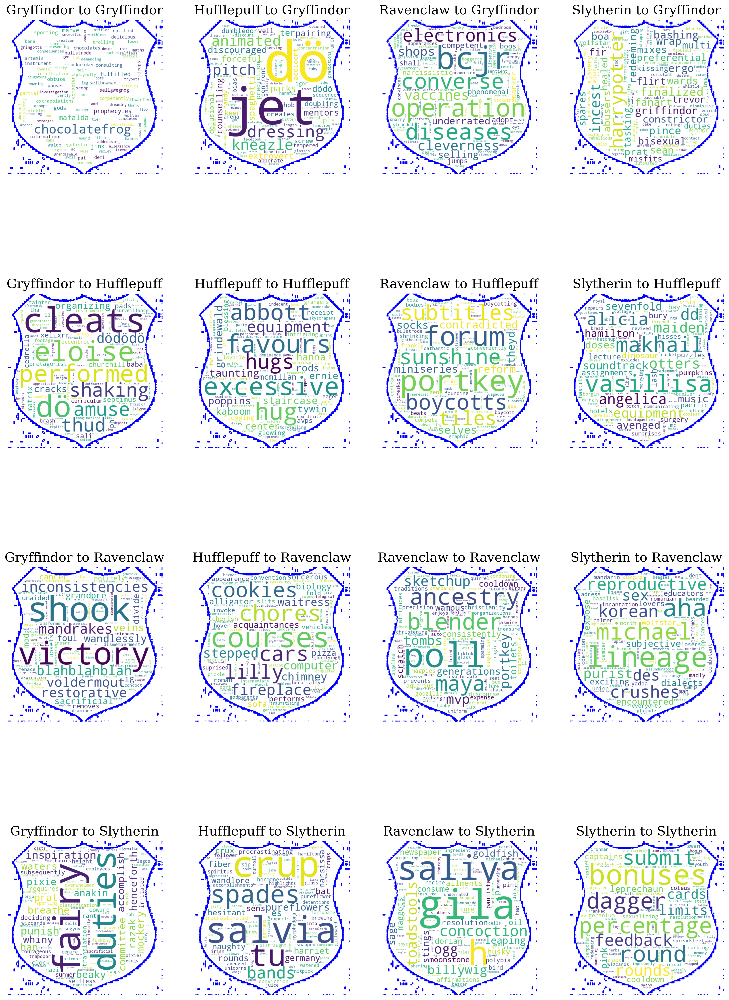

In [ ]:
houses = ["Gryffindor", "Hufflepuff", "Ravenclaw", "Slytherin"]
shield_mask = np.array(Image.open('wordcloud_contours/shield_contour.jpg'))


width, height = 4, 4
fig, ax = plt.subplots(height,width, dpi = 300, figsize = (20,30))
titles = [f"{h1} to {h2}" for h1 in houses for h2 in houses]
font = {'family': 'serif',
        'weight': 'normal',
        'size': 20,
        }

i = 0    
for col in tqdm(range(width)):
    for row in tqdm(range(height)):
        # user = users[i]
        # user_house = df_submissions[df_submissions['author'] == user]['house'].iloc[0]
        # user_color = title_color[user_house]
        wordcloud = WordCloud(width = 400*width,
                    height = 400*height,
                    max_words=100,
                    background_color ='white',
                    mask=shield_mask,
                    contour_width=3,
                    contour_color="blue").generate_from_frequencies(dict(interactions.TF_IDF[i]))
        ax[row,col].imshow(wordcloud, interpolation='bilinear')
        ax[row,col].set_axis_off()
        ax[row,col].set_title(f"{interactions.house[i]} to {interactions.parent_house[i]}", fontdict = font, backgroundcolor='white')
        i += 1
    
plt.savefig("figures/wordcloud_comments_houses_tf_idf.png")
plt.show()

### Based on TF

100%|██████████| 4/4 [00:17<00:00,  4.32s/it]


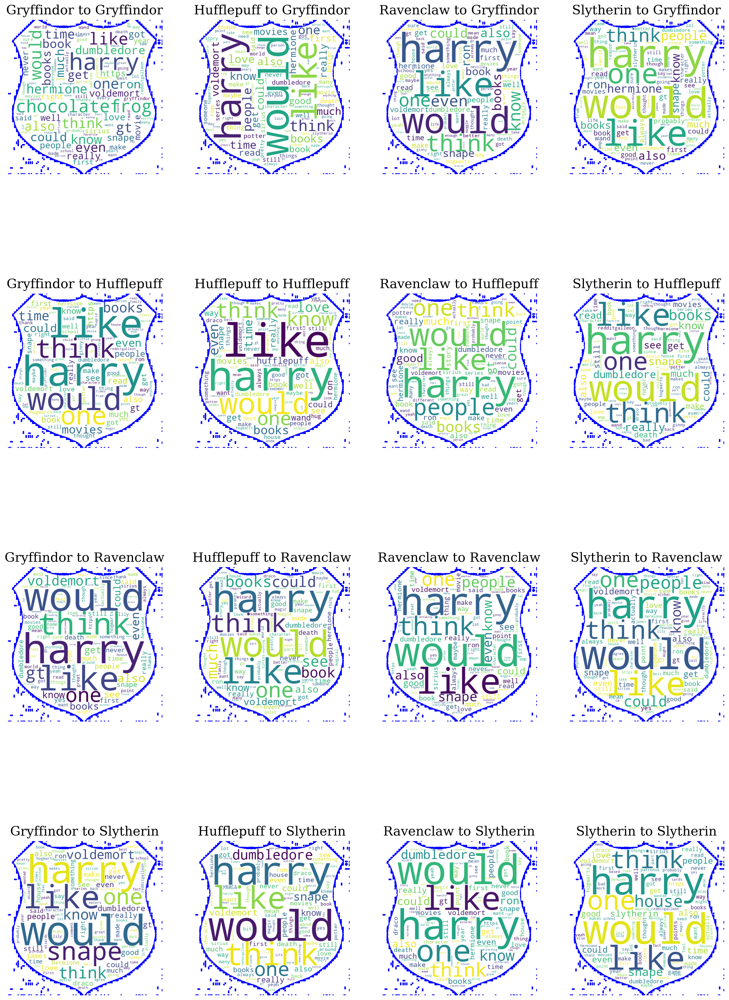

In [ ]:
houses = ["Gryffindor", "Hufflepuff", "Ravenclaw", "Slytherin"]
shield_mask = np.array(Image.open('wordcloud_contours/shield_contour.jpg'))


width, height = 4, 4
fig, ax = plt.subplots(height,width, dpi = 300, figsize = (20,30))
font = {'family': 'serif',
        'weight': 'normal',
        'size': 20,
        }

i = 0    
for col in tqdm(range(width)):
    for row in tqdm(range(height)):
        wordcloud = WordCloud(width = 400*width,
                    height = 400*height,
                    max_words=100,
                    background_color ='white',
                    mask=shield_mask,
                    contour_width=3,
                    contour_color="blue").generate_from_frequencies(dict(interactions.TF[i]))
        ax[row,col].imshow(wordcloud, interpolation='bilinear')
        ax[row,col].set_axis_off()
        ax[row,col].set_title(f"{interactions.house[i]} to {interactions.parent_house[i]}", fontdict = font, backgroundcolor='white')
        i += 1
    
plt.savefig("figures/wordcloud_comments_houses_tf.png")
plt.show()

# Interactive

In [ ]:
!pip install ipywidgets
from __future__ import print_function
from ipywidgets import interact, interactive, fixed, interact_manual
import ipywidgets as widgets

     |████████████████████████████████| 121 kB 19.5 MB/s 
     |████████████████████████████████| 2.2 MB 54.2 MB/s 
     |████████████████████████████████| 243 kB 61.8 MB/s 
You should consider upgrading via the '/root/venv/bin/python -m pip install --upgrade pip' command.


In [ ]:
# def emotion_score(str:emotion):
#     return interactions.emotion_score[0][emotion]

def f(x):
    return x

interact(f, x = 10)

10

<function __main__.f(x)>

<a style='text-decoration:none;line-height:16px;display:flex;color:#5B5B62;padding:10px;justify-content:end;' href='https://deepnote.com?utm_source=created-in-deepnote-cell&projectId=85fb65b4-b596-4730-837e-04e86eafe419' target="_blank">
 </img>
Created in <span style='font-weight:600;margin-left:4px;'>Deepnote</span></a>